<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# Project 4 - West Nile Virus Prediction (Kaggle Competition)

# 05 Cost Benefit Analysis of Interventions Against The West Nile Virus

## Libraries & Data Import

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle

import folium
from folium.plugins import MarkerCluster, HeatMapWithTime, HeatMap
from geopy.distance import geodesic
from branca.element import Figure

import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
%config InlineBackend.figure_format = 'retina' # Render high resolution images

In [2]:
# import cleaned datasets/ original Kaggle datasets 
spray = pd.read_csv("../assets/spray_cleaned.csv")
train = pd.read_csv("../assets/train.csv")

In [3]:
train['Date'] = pd.to_datetime(train['Date'])

In [4]:
spray['Date'] = pd.to_datetime(spray['Date'])

In [5]:
#2011 and 2013 spray dates
spray_2011 = spray['Date'].unique()[:1]
spray_2013 = spray['Date'].unique()[1:]

In [6]:
#2011 and 2013 wnv from train set
wnv_2011 = train[train['Date'].dt.year==2011].groupby('Date')['WnvPresent'].sum()
wnv_2013 = train[train['Date'].dt.year==2013].groupby('Date')['WnvPresent'].sum()

In [7]:
#2011 and 2013 num mosquitos from train set
mosquitos_2011 = train[train['Date'].dt.year==2011].groupby('Date')['NumMosquitos'].sum()
mosquitos_2013 = train[train['Date'].dt.year==2013].groupby('Date')['NumMosquitos'].sum()

## Graphs of the Mosquito Count vs Spray and West Nile Virus Mosquito vs Spray in 2011

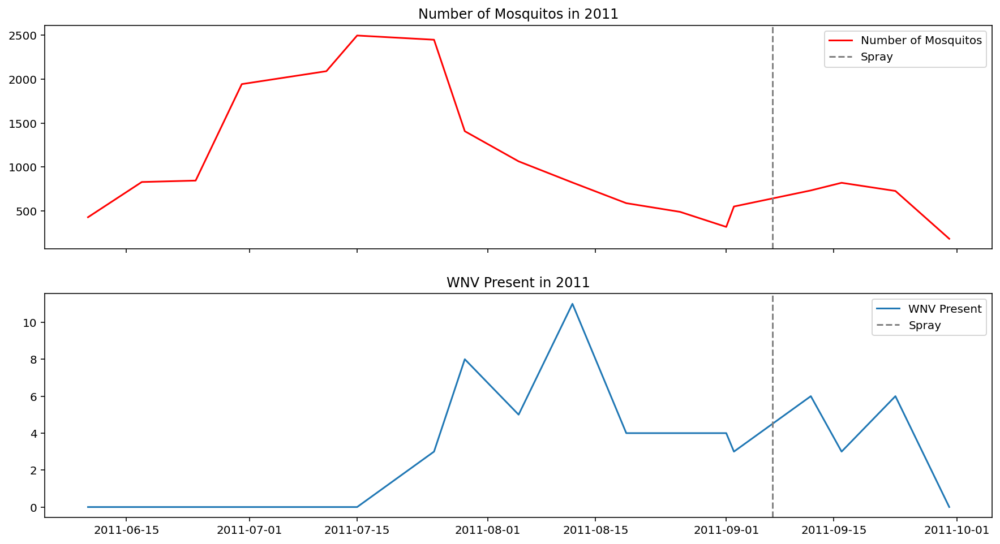

In [8]:
fig, axes = plt.subplots(nrows=2,sharex=True, figsize=(15,8))

#plot num mosquitos in 2011 against spray dates
axes[0].plot(mosquitos_2011.index,mosquitos_2011.values,color='red')
for spray_date in spray_2011:
    axes[0].axvline(x=spray_date, color='grey', ls='--')
axes[0].set_title('Number of Mosquitos in 2011')
axes[0].legend(['Number of Mosquitos','Spray']);

#plot wnv in 2011 against spray dates
axes[1].plot(wnv_2011.index,wnv_2011.values)
for spray_date in spray_2011:
    axes[1].axvline(x=spray_date, color='grey', ls='--')
axes[1].set_title('WNV Present in 2011')
axes[1].legend(['WNV Present','Spray']);

From the observations charted above, we can view that the mosquito number trends do not seem affected by the spraying efforts that were carried out

## Viewing similar graphs in 2013

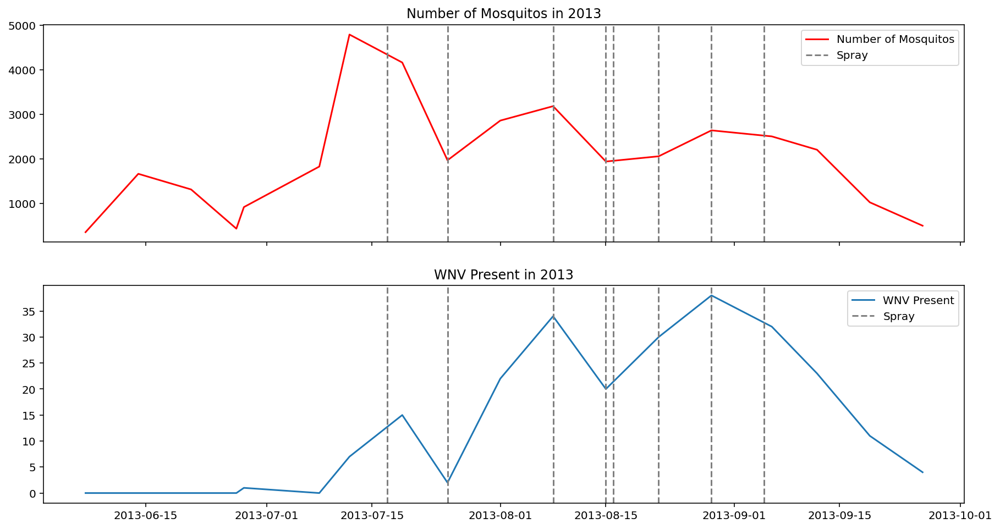

In [9]:
fig, axes = plt.subplots(nrows=2,sharex=True, figsize=(15,8))

#plot num mosquitos in 2013 against spray dates
axes[0].plot(mosquitos_2013.index,mosquitos_2013.values,color='red')
for spray_date in spray_2013:
    axes[0].axvline(x=spray_date, color='grey', ls='--')
axes[0].set_title('Number of Mosquitos in 2013')
axes[0].legend(['Number of Mosquitos','Spray']);

#plot wnv in 2013 against spray dates
axes[1].plot(wnv_2013.index,wnv_2013.values)
for spray_date in spray_2013:
    axes[1].axvline(x=spray_date, color='grey', ls='--')
axes[1].set_title('WNV Present in 2013')
axes[1].legend(['WNV Present','Spray']);

From the week of 17 July 2013, spraying seemed to affect the number of mosquitoes as there was a decrease, however, the 2nd spray onwards do not seem to affect, and the number of mosquitoes seemed to increase sharply thereafter.

Assumption points
- These graphs reflected the total mosquitos vs spray
- This may not refect the actual spraying locale. Spraying might affect the locality, but not the mosquitoes in the total area of Chicago<br>

Thus we want to plot maps to view how and whether the spraying worked

## Map

In [10]:
spray_df = pd.read_csv('../assets/spray.csv')
spray_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14835 entries, 0 to 14834
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Date       14835 non-null  object 
 1   Time       14251 non-null  object 
 2   Latitude   14835 non-null  float64
 3   Longitude  14835 non-null  float64
dtypes: float64(2), object(2)
memory usage: 463.7+ KB


In [11]:
df = pd.read_csv('../assets/train.csv')

In [12]:
# Station 1: CHICAGO O'HARE INTERNATIONAL AIRPORT Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level
# Station 2: CHICAGO MIDWAY INTL ARPT Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level
def assign_station(lat:int, lng:int):
    coord_stn1 = (41.995, -87.933)
    coord_stn2 = (41.786, -87.752)
    coord_curr = (lat, lng)
    return 1 if geodesic(coord_curr, coord_stn1) < geodesic(coord_curr, coord_stn2) else 2

    
lst = ['Trap', 'Address', 'Block', 'Street', 'AddressNumberAndStreet','Latitude', 'Longitude', 'AddressAccuracy']
dim_loc = df[lst].drop_duplicates()
dim_loc[['Overall Latitude', 'Overall Longitude']] = np.round(dim_loc[['Latitude', 'Longitude']], 3)
dim_loc['Station'] = dim_loc.apply(lambda x: assign_station(x['Latitude'], x['Longitude']), axis=1)

In [13]:
spray_df[['Overall Latitude', 'Overall Longitude']] = np.round(spray_df[['Latitude', 'Longitude']], 3)

In [14]:
dim_loc

,Trap,Address,Block,Street,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,Overall Latitude,Overall Longitude,Station
0,T002,"4100 North Oak Park Avenue, Chicago, IL 60634,...",41,N OAK PARK AVE,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,41.955,-87.801,1
2,T007,"6200 North Mandell Avenue, Chicago, IL 60646, USA",62,N MANDELL AVE,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,41.995,-87.769,1
3,T015,"7900 West Foster Avenue, Chicago, IL 60656, USA",79,W FOSTER AVE,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,41.974,-87.825,1
5,T045,"1500 West Webster Avenue, Chicago, IL 60614, USA",15,W WEBSTER AVE,"1500 W WEBSTER AVE, Chicago, IL",41.921600,-87.666455,8,41.922,-87.666,2
6,T046,"2500 West Grand Avenue, Chicago, IL 60654, USA",25,W GRAND AVE,"2500 W GRAND AVE, Chicago, IL",41.891118,-87.654491,8,41.891,-87.654,2
...,...,...,...,...,...,...,...,...,...,...,...
7466,T236,"6200 North Mcclellan Avenue, Chicago, IL 60646...",62,N MCCLELLAN AVE,"6200 N MCCLELLAN AVE, Chicago, IL",41.994679,-87.770899,8,41.995,-87.771,1
7635,T237,"2900 West 85th Street, Chicago, IL 60652, USA",29,W 85TH ST,"2900 W 85TH ST, Chicago, IL",41.738903,-87.695443,8,41.739,-87.695,2
7821,T238,"3400 West 77th Street, Chicago, IL 60652, USA",34,W 77TH ST,"3400 W 77TH ST, Chicago, IL",41.753391,-87.707394,8,41.753,-87.707,2
8667,T094B,"9600 South Longwood Drive, Chicago, IL 60643, USA",96,S LONGWOOD DR,"9600 S LONGWOOD DR, Chicago, IL",41.719140,-87.669539,9,41.719,-87.670,2


In [15]:
#Create the base Map

from branca.element import Figure
fig=Figure(width=1100,height=900)


m = folium.Map(width=1100,height=900, location=[41.904,-87.756], tiles='cartodbpositron', zoom_start=11)
folium.Marker(location=[41.995, -87.933],tooltip="CHICAGO O'HARE INTERNATIONAL AIRPORT", icon=folium.Icon(color='black')).add_to(m)
folium.Marker(location=[41.786, -87.752],tooltip="CHICAGO MIDWAY INTL ARPT", icon=folium.Icon(color='purple')).add_to(m)

#Create the markers
#sprayCluster = MarkerCluster().add_to(m)
for i, row in spray_df.iterrows():
    lat = spray_df.at[i,'Overall Latitude']
    lng = spray_df.at[i,'Overall Longitude']
    date_sprayed = spray_df.at[i,'Date']
    popup = 'date sprayed: ' + str(date_sprayed) + '\n' + str(lat)+ '\n' + str(lng)
    folium.CircleMarker(location=[lat, lng],tooltip=popup, color='red', radius=2, fill=True, opacity=0.5, fill_opacity=0.5).add_to(m)    
    

test_df = dim_loc[dim_loc['Station'] == 1]    
#Create the markers
#stn1Cluster = MarkerCluster().add_to(m)
for i, row in test_df.iterrows():
    lat = test_df.at[i,'Overall Latitude']
    lng = test_df.at[i,'Overall Longitude']
    trap = test_df.at[i,'Trap']
    name = test_df.at[i,'AddressNumberAndStreet']
    popup = trap + '\n' + str(name) + '\n' + str(lat)+ '\n' + str(lng)
    folium.CircleMarker(location=[lat, lng],tooltip=popup,color='blue', radius=4, opacity=0.5).add_to(m)    

    
test_df = dim_loc[dim_loc['Station'] == 2]
#Create the markers
#stn2Cluster = MarkerCluster().add_to(m)
for i, row in test_df.iterrows():
    lat = test_df.at[i,'Overall Latitude']
    lng = test_df.at[i,'Overall Longitude']
    trap = test_df.at[i,'Trap']
    name = test_df.at[i,'AddressNumberAndStreet']
    popup = trap + '\n' + str(name) + '\n' + str(lat)+ '\n' + str(lng)
    folium.CircleMarker(location=[lat, lng],tooltip=popup, color='darkblue', radius=4, opacity=0.8).add_to(m)     

fig.add_child(m)
m

Sprayed Area in 2011 and 2013 vs the number of traps in Chicago area. From here, we can tell that sprayed areas seem to happen more nearer to Station 1, but it still doesn't really give us an indication of whether mosquito numbers are affected. Could it be that there are more mosquito numbers in the Northern side of Chicago compared to the Southern side?

In [16]:
# Opening previously saved train dataset
infile = open('../assets/train.pkl', 'rb')
wnv = pickle.load(infile)
infile.close()

In [17]:
# View the coverage of the traps

# Create latitude and longitude list for traps in train data
lat_long_train = []

for trap in wnv['Trap'].unique():
    lat = wnv.loc[wnv['Trap'] == trap, 'Latitude'].values[0]
    long = wnv.loc[wnv['Trap'] == trap, 'Longitude'].values[0]
    lat_long_train.append([trap, (lat, long)])

In [18]:
# Create dataframe with total number of mosquitoes at each date and trap
group_mosq = wnv.groupby(['Date', 'Trap','WnvPresent'], as_index=False).sum()
group_mosq = group_mosq.loc[group_mosq['WnvPresent']==1]
group_mosq['Date_Type'] = pd.to_datetime(group_mosq['Date'])

group_mosq = group_mosq.loc[group_mosq['Date_Type'].dt.year >= 2011]
# group_mosq.head()

In [19]:
# for spray
# Create latitude and longitude list to pass into map
lat_long_spray = []
for date in spray['Date'].unique():
    temp = []
    for i, row in spray[spray['Date'] == date].iterrows():
        temp.append([row['Latitude'], row['Longitude']])
    lat_long_spray.append(temp)

In [20]:
# for number of mosquitoes
# Create latitude and longitude list to pass into map
lat_long_mosq = []
for date in group_mosq['Date'].unique():
    temp = []
    for i, row in group_mosq[group_mosq['Date'] == date].iterrows():
        temp.append([row['Latitude'], row['Longitude'], row['NumMosquitos']])
    lat_long_mosq.append(temp)

In [21]:
# Plot the map for spraying efforts
# Blue dots indicate the trap locations
fig = Figure(width=850, height=550)
m1 = folium.Map(location=[41.9, -87.7], zoom_start=9, min_zoom=9, max_zoom=11)
# tiles='cartodbdark_matter'
fig.add_child(m1)


gradient = {.33: 'blue', .66: 'green', 1: 'yellow'}
gradient2 = {.33: 'yellow', .66: 'blue', 1: 'red'}


HeatMapWithTime(lat_long_spray, index=list(np.datetime_as_string(spray['Date'].unique(), unit='D').astype('object')),radius=0.03, gradient=gradient, position='bottomright', name='spray_zones', scale_radius=True, control=True).add_to(m1)

HeatMapWithTime(lat_long_mosq, index=list(np.datetime_as_string(group_mosq['Date'].unique(), unit='D').astype('object')), gradient=gradient2, name='WnV Spread', radius=20, position='bottomright', control=True).add_to(m1)

folium.LayerControl().add_to(m1)


for item in lat_long_train:
    folium.CircleMarker(item[1], radius=1).add_to(m1)

m1

### Below shows a gif of the evolution of West Nile Virus Clusters around the trap areas vs the Yellow Sprayed Areas in the corresponding time period.

The spray is able to last for 30 days, thus we want to see the correlation between the sprayed areas and within the time period of 30 days and whether the West Nile Virus clusters are reduced. However, it seems that it might not really be the case.

![SprayVsWNV](../images/SprayvsWnV.gif "WnV")

## Predictions

In [23]:
prediction = pd.read_csv("../assets/prediction_probability_with_traps.csv")

In [25]:
prediction.head(3)

,Latitude,Longitude,0,1
0,41.95469,-87.800991,0.643516,0.356484
1,41.95469,-87.800991,0.643516,0.356484
2,41.95469,-87.800991,0.643516,0.356484


In [26]:
def apply_weight(x):
    if x<0.5: return 0
    else: return 1
prediction['1'] = prediction['1'].apply(lambda x: apply_weight(x))
prediction.head(3)

,Latitude,Longitude,0,1
0,41.95469,-87.800991,0.643516,0
1,41.95469,-87.800991,0.643516,0
2,41.95469,-87.800991,0.643516,0


In [27]:
virus_present = prediction[prediction['1']==1]
virus_present = virus_present.drop_duplicates(subset = 'Trap')

In [40]:
virus_present

,Latitude,Longitude,0,1


There are 149 unique traps where the virus is predicted to be present.

In [29]:
# Plot data on map
dataplot = []
tempdata = []

for i, row in prediction.iterrows():
    dataplot.append([row['Latitude'],row['Longitude'],row['1']])
    if row['1'] != 0:
        tempdata.append([row['Latitude'],row['Longitude'],row['1']])

### Below shows the predicted hotspots of future possible West Nile Virus Clusters

In [30]:
# Plot the map for spraying efforts
# Blue dots indicate the trap locations
fig = Figure(width=850, height=550)
m2 = folium.Map(location=[41.9, -87.7], zoom_start=9, min_zoom=9, max_zoom=11)
# tiles='cartodbdark_matter'
fig.add_child(m2)


# gradient = {.33: 'yellow', .66: 'green', 1: 'red'}
# gradient2 = {.33: 'yellow', .66: 'blue', 1: 'red'}


HeatMap(tempdata,radius=10, name='predictions', control=True).add_to(m2)

# HeatMapWithTime(lat_long_mosq, index=list(np.datetime_as_string(group_mosq['Date'].unique(), unit='D').astype('object')), gradient=gradient2, name='WnV Spread', radius=20, position='bottomright', control=True).add_to(m2)

folium.LayerControl().add_to(m2)


for item in lat_long_train:
    folium.CircleMarker(item[1], radius=1,color='red').add_to(m2)

m2

In [41]:
#Save the respective maps
m.save("../maps/TrapVsSprayloc.html")
m1.save("../maps/SprayVsWnV.html")
m2.save("../maps/FuturePred.html")

## Cost-Benefit Analysis

### Spraying

The Chicago Department of Public Health (CDPH) is continuing its efforts to combat against the West Nile virus, even in [2020](https://www.chicago.gov/city/en/depts/cdph/provdrs/healthy_communities/news/2020/august/city-to-spray-insecticide-thursday-to-kill-mosquitoes0.html). The insecticide used by the CDPH is the [Zenivex E4](https://www.chicago.gov/content/dam/city/depts/cdph/Mosquito-Borne-Diseases/Zenivex.pdf). Zenivex™, is approved for use by the U.S. Environmental Protection Agency and has been widely applied to control mosquitoes in outdoor residential and recreational areas.

A typical mosquito treatment [lasts about 30 days and the spray dispersement covers up to 300ft](https://www.callnorthwest.com/2019/05/how-long-does-a-mosquito-treatment-last/).

![zenivex.jpg](../images/zenivex.jpg)

The cost of Zenivex E4 is $0.92 per acre. 

The entire city of Chicago has an area size of 606.60 km2. Chicago has very few water bodies, and the land area size totals to 588.98 km2 (145545 acres).

In [32]:
#The cost of spraying the full land size of Chicago  
chicago_spray_cost = 0.92 * 145545
chicago_spray_cost

133901.4

In [33]:
#As the effect of spraying lasts for 30 days, for a full-year coverage, spraying will need to be performed 12 times
chicago_spray_cost= chicago_spray_cost * 12
chicago_spray_cost

1606816.7999999998

Chicago only launched the data science model in [2017](https://datasmart.ash.harvard.edu/news/article/predictive-analytics-guides-west-nile-virus-control-efforts-in-chicago-1152), thus whatever basis they were operating on previously, was probably weak.

Assuming that they are not utilizing any form of data science insights, the brute-force approach would cost $1,606,816.80 yearly. 

Next, let’s calculate the cost of spraying derived from our model’s insights.

Culex mosquitoes don’t fly long distances but have been known to fly up to [2 miles (10,000 ft)](https://www.cdc.gov/mosquitoes/about/life-cycles/culex.html). 

It’s unrealistic to spray over a radius of 10,000ft. Instead, a 10% coverage would be more than enough; 1,000ft is STILL a huge radius for spraying.

In [34]:
#Area size of each trap = πr**2 
#Radius of 700ft because spraying has a 300ft dispersement coverage
trap_area = 3.14 * 700**2
trap_area

1538600.0

In [35]:
#Convert sqft to acres
trap_area = trap_area/43560
trap_area

35.321395775941234

In [36]:
#Cost required for each trap = trap_area x zenivex cost
trap_cost = trap_area * 0.92
trap_cost

32.495684113865934

In [37]:
#Total cost = [cost of each trap] x [number of traps] x [number of sprayings]
#The model predicted 149 unique traps where the virus is present
total_cost = trap_cost * 149 * 12
total_cost

58102.28319559229

In [38]:
spray_savings = chicago_spray_cost - total_cost
spray_savings

1548714.5168044076

Referring to the map that shows the spraying efforts in 2011 and 2013, we can see that the CDPH did NOT spray the entire city of Chicago once every month. 

However, in the spraying cost analysis, we assumed that the CDPH is operating with no insights. As such, we explored the comparison between the potential decision-making derived from the model's prediction, against a baseline scenario where there are no insights to work with.

In this context, a 96%($1,548,714.51) cost savings will be achieved for spraying efforts. 

### Hospitalization and Lost Productivity

From 1999 through 2012, health care expenses and lost productivity in the US totalled up to $800 million. 

Out of the 37,088 WNV cases, 1,529 (4%) died and an estimated 18,313 (49%) of the total cases were hospitalized.

[Below is a table that shows the cost breakdown upon contracting the WNV](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3322011/).

![hospital_cost.jpg](../images/hospital_cost.jpg)

As shown above, different severities of the WNV will result in varying treatment costs. 

Back in 2002, Chicago suffered its first, and most severe, WNV epidemic: [225 human cases were reported, including 22 fatalities](https://www.cityofchicago.org/dam/city/depts/cdph/comm_dis/general/Communicable_Disease/CD_CDInfo_Jun07_WNV.pdf).

Assuming only the initial costs and the cases with just fever (mean = $7,500), the estimated yearly hospitalization costs in Chicago are AT LEAST:

In [39]:
#$7,500 as a minimum cost
#225 potential cases
hospitalization = 7500 * 225
hospitalization

1687500

Through our model, we are confident to predict 60% of the WNV (based on the recall score of 0.606). By deploying interventions to eradicate carrier mosquitos or to notify potential infected citizens for early treatment, we would be able to save ~$1,000,000 on initial hospitalization costs.

## Conclusions & Recommendations

Although the Gradient Boosting model has the strongest ROC AUC score, its recall score (0.527) pales in comparison to that of Adaboost (0.606). This means that we are likely to have fewer False Negatives using Adaboost.

Support Vector Classification is also a possible consideration, but it fared worse in terms of the ROC AUC score and precision score compared to Adaboost.

AdaBoost, with a test AUC of 0.837 and recall score of 0.606, seems like the best model as it is important to ensure a relatively high recall score that does not compromise the ROC AUC and/or precision score.

Our model was able to achieve significant cost-savings. However, the WNV prediction rate could be better. More data points would be helpful.

The cost analysis was over-simplified and not performed on a macro level. For example, the cost calculation on spraying did not account for logistics / manhour costs. Some traps were within a 700ft radius between one another; the spraying of traps overlaps and the actual required insecticide is less. In addition, the cost calculation for hospitalization fees was also generalized. To perform a proper cost analysis, we would need to look at the most recent data for an accurate assessment of the current status. Only then can a fair comparison be made.

In addition, understanding the CDPH's basis of operations will also help in bridging the current situation towards their desired KPIs. They mentioned about other efforts including larviciding catch basins, which involves dropping tablets in storm drains along the public way that slowly dissolve over a five-month period to prevent mosquito larvae from hatching, and eliminating standing water by ensuring that swimming pools and construction sites are regularly maintained. These additional efforts beyond spraying and trapping could be explored, and data can be collected on those variables to build a more robust model.